# 2018/2019 - Task List 1

1. Generate random variable from prefered dystribution using Pyro (pyro.sample)
    
    - animate how distribution of values changes
    - animate histograms of values
    - start with empty list of values, generate new samples, generate histogram
    
    
2. Write a simulator (and exact solution utilizing Bayes theorem) for chances to be ill on a certain disease. We know that it affects from about 1 to 100 out of 50,000 people. There was developed a test to check whether the person has the disease and it is quite accurate: the probability that the test result is positive (suggesting the person has the disease), given that the person does not have the disease, is only 2 percent; the probability that the test result is negative (suggesting the person does not have the disease), given that the person has the disease, is only 1 percent. When a random person gets tested for the disease and the result comes back positive, what is the probability that the person has the disease? Check whole parameter space and visualise results.

    - it must be a simulator!
    - sample from distribution using given probabilities
    - repeate experiment and compare with Bayes equation


## Required imports

In [10]:
%matplotlib inline
import pyro
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.path as path
from matplotlib import animation, rc
from IPython.display import HTML

## Generating single value from normal distribution with given mean and variance

In [11]:
mean = 0
variance = 10
x = pyro.sample("normal_sampling", pyro.distributions.Normal(mean, variance))
print(x)

tensor(9.1994)


## Sampling from categorical probabilities with given probabilities

In [12]:
x = pyro.sample("categorical_sampling", pyro.distributions.Categorical(logits = torch.tensor([0.5, 0.5])))
print(x)

tensor(1)


## Animating data

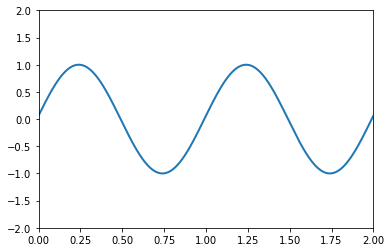

In [13]:
def animate():
    # First set up the figure, the axis, and the plot element we want to animate
    fig, ax = plt.subplots()

    ax.set_xlim(( 0, 2))
    ax.set_ylim((-2, 2))

    line, = ax.plot([], [], lw=2)
    
    # animation function. This is called sequentially
    def sin(i):
        x = np.linspace(0, 2, 1000)
        y = np.sin(2 * np.pi * (x - 0.01 * i))
        line.set_data(x, y)
        return (line,)

    # initialization function: plot the background of each frame
    def init():
        line.set_data([], [])
        return (line,)
    # call the animator. blit=True means only re-draw the parts that have changed.
    anim = animation.FuncAnimation(fig, sin, init_func=init,
                                   frames=100, interval=20, blit=True)
    return HTML(anim.to_jshtml())

animate()

## Drawing histogram

[-3.27013633 -3.06617952 -2.86222271 -2.6582659  -2.45430909 -2.25035228
 -2.04639547 -1.84243866 -1.63848185 -1.43452504 -1.23056823 -1.02661142
 -0.82265461 -0.6186978  -0.41474099 -0.21078418 -0.00682737  0.19712944
  0.40108625  0.60504306  0.80899987  1.01295668  1.21691349  1.4208703
  1.62482711  1.82878392  2.03274073  2.23669754  2.44065435  2.64461116] [ 0.009806    0.004903    0.004903    0.009806    0.014709    0.04412699
  0.03922399  0.06864198  0.11767197  0.15689596  0.15199296  0.20102295
  0.32850092  0.36282191  0.4069489   0.48049388  0.4020459   0.30888893
  0.36282191  0.25495594  0.28927693  0.23534394  0.19611995  0.14218697
  0.11276897  0.06864198  0.05393299  0.03922399  0.019612    0.014709  ]


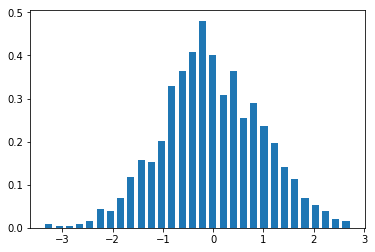

In [20]:
x = np.random.normal(size = 1000)
hist, bins = np.histogram(x, density=True, bins=30)
width = 0.7 * (bins[1] - bins[0])
center = (bins[:-1] + bins[1:]) / 2
plt.bar(center, hist, align='center', width=width)
plt.show()

## Task 1

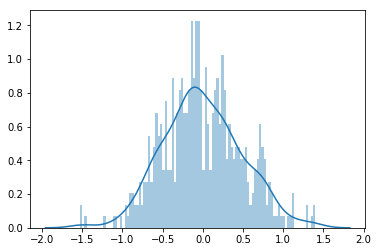

In [84]:
import pyro
import torch
import seaborn as sns
from matplotlib import animation, rc
from IPython.display import HTML

def animate2():
    
    fig, ax = plt.subplots()

    ax.set_xlim((-2,2))
    ax.set_ylim((0,1.5))
    
    mi = 0
    sigma = 0.5
    data = []
    
    def animate(i):
        data.append(pyro.sample("normal_sampling", pyro.distributions.Normal(mi, sigma)))
        ax.clear()
        sns.distplot(data, bins=100)
    
    def init():
        line.set_data([], [])
        return (line,)
    
    # call the animator. blit=True means only re-draw the parts that have changed.
    anim = animation.FuncAnimation(fig, animate, frames=500, interval=100)
    return HTML(anim.to_jshtml())

animate2()

## Task 2

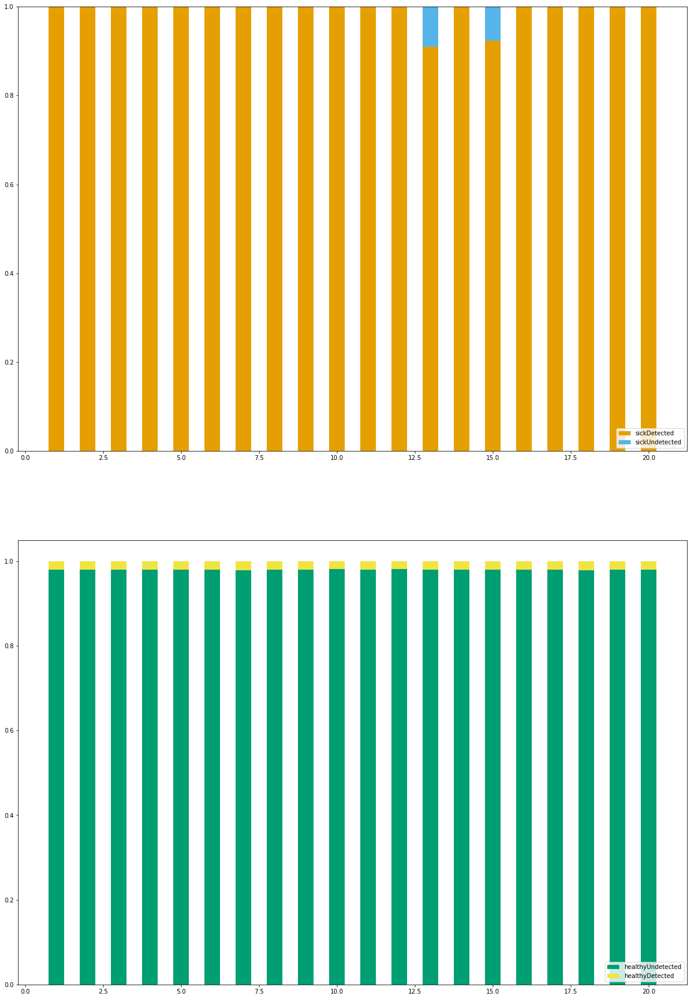

In [32]:
## Insert solution here
# D - ma chorobe
# ~D - nie ma choroby
# Pos - wynik pozytywny testu
# Neg - wynik negatywny
## P(D) = od 0.00002 do 0.002
## P(Pos|~D) = 0.02 P(Pos|D) = 0.98 
## P(Neg|D) = 0.01 P(Neg|~D) = 0.99
#P(D, Pos) = P(D)P(Pos|D) = od 0.0000196 do 0.00196
#P(~D, Pos) = P(~D)P(Pos|~D) ~ 0.02
#P(Pos) = P(D, Pos) + P(~D, Pos) ~ 0.02196 
#P(D|Pos) = P(Pos|D)P(D)/P(Pos) = 0.98 * (0.00002 do 0.002)/0.02 = 0.098 lub 0.00098
#P(~D|Pos) = P(Pos|~D)P(~D)/P(Pos) = 0.02 * (0.99998 do 0.998)/0.02 = 0.909 lub 0.00002

import pyro
import torch
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
from collections import Counter
import numpy as np

pIsSick = k/50000
nIsSick = 1 - k/50000
P(Pos|~D) = 0.02


def myBernolli(guess):
    return pyro.sample("guess", pyro.distributions.Bernoulli(guess))

def myBayes(pp, np, sample):
    if sample:
        return pyro.sample("guess", pyro.distributions.Bernoulli(pp)).item()
    else:
        return pyro.sample("guess", pyro.distributions.Bernoulli(np)).item()

def getIlnessData(num):
    sick = [0]*num
    sickDetected = [0]*num
    sickUndetected = [0]*num
    healthy = [0]*num
    healthyDetected = [0]*num
    healthyUndetected = [0]*num
    
    for k in range(1, num+1):
        for i in range(50000):
            sample = myBernolli(k/50000).item()
            if sample:
                sick[k-1] += 1
                test = myBayes(0.99, 0.02, sample)
                if test:
                    sickDetected[k-1] += 1
                else:
                    sickUndetected[k-1] += 1
            else:
                healthy[k-1] += 1
                test = myBayes(0.99, 0.02, sample)
                if test:
                    healthyDetected[k-1] += 1
                else:
                    healthyUndetected[k-1] += 1
                    
        sickDetected[k-1] /= sick[k-1]
        sickUndetected[k-1] /= sick[k-1]
        healthyDetected[k-1] /= healthy[k-1]
        healthyUndetected[k-1] /= healthy[k-1]

    return {'sick': sick, 'sickDetected': sickDetected, 'sickUndetected': sickUndetected,
           'healthy': healthy, 'healthyDetected': healthyDetected, 'healthyUndetected': healthyUndetected}

colors = ['#E69F00', '#56B4E9', '#F0E442', '#009E73', '#D55E00', '#0000FF']
names = ['sick', 'sickDetected', 'sickUndetected',
         'healthy', 'healthyDetected', 'healthyUndetected']
    
data = getIlnessData(20)
sickDetected = list(data.values())[1]
sickUndetected = list(data.values())[2]
healthyDetected = list(data.values())[4]
healthyUndetected = list(data.values())[5]

plt.figure(figsize=(20, 30))
plt.subplot(2, 1, 1)
plt.bar(range(1,21), sickDetected, width=0.5, color='#E69F00', label='sickDetected', align='center')
plt.bar(range(1,21), sickUndetected, width=0.5, bottom=sickDetected, color='#56B4E9',
        label='sickUndetected', align="center")
plt.legend(['sickDetected', 'sickUndetected'], loc=4)
plt.subplot(2, 1, 2)
plt.bar(range(1,21), healthyUndetected, width=0.5,
        color='#009E73', label='healthyUndetected', align="center")
plt.bar(range(1,21), healthyDetected, width=0.5, bottom=healthyUndetected,
        color='#F0E442', label='healthyDetected',align="center")
plt.legend(['healthyUndetected', 'healthyDetected'], loc=4)
plt.show()

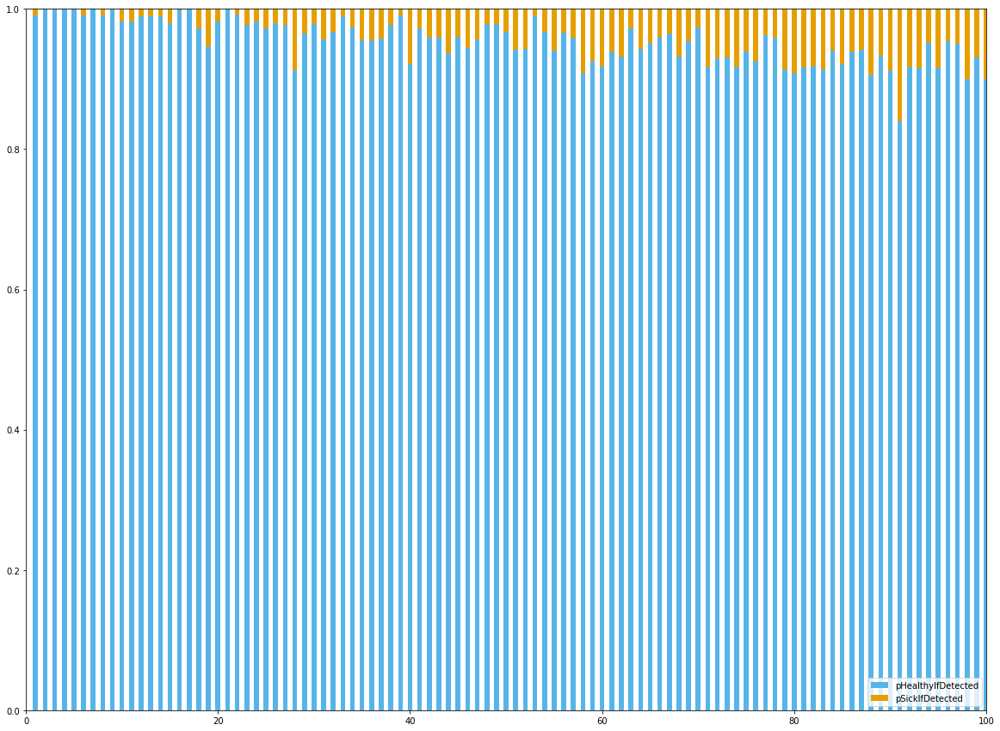

In [88]:
import pyro
import torch
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML

def animate3(arg, num):
    
    fig, ax = plt.subplots(figsize=(20, 15))
    
    ax.set_xlim(0, num)
    ax.set_ylim(0, 1)
    ax.set_xlabel('k')
    ax.set_ylabel('probability')
    
    sick = [0]*num
    sickDetected = [0]*num
    sickUndetected = [0]*num
    healthy = [0]*num
    healthyDetected = [0]*num
    healthyUndetected = [0]*num
    pSickIfDetected = [0]*num
    pHealthyIfDetected = [0]*num
    
    def myBernolli(guess):
        return pyro.sample("guess", pyro.distributions.Bernoulli(guess))

    def myBayes(pp, np, sample):
        if sample:
            return pyro.sample("guess", pyro.distributions.Bernoulli(pp)).item()
        else:
            return pyro.sample("guess", pyro.distributions.Bernoulli(np)).item()
        
    def generate():
        for k in range(1, num+1):
            for i in range(arg):
                sample = myBernolli(k/50000).item()
                if sample:
                    sick[k-1] += 1
                    test = myBayes(0.99, 0.02, sample)
                    if test:
                        sickDetected[k-1] += 1
                    else:
                        sickUndetected[k-1] += 1
                else:
                    healthy[k-1] += 1
                    test = myBayes(0.99, 0.02, sample)
                    if test:
                        healthyDetected[k-1] += 1
                    else:
                        healthyUndetected[k-1] += 1
                        
            detected = healthyDetected[k-1] + sickDetected[k-1]
            if detected > 0:
                pSickIfDetected[k-1] = sickDetected[k-1]/detected
                pHealthyIfDetected[k-1] = healthyDetected[k-1]/detected
            
    
    def animate(i):
        generate()
        ax.clear()
        ax.bar(range(1,num+1), pHealthyIfDetected, width=0.5, color='#56B4E9',
                label='pHealthyIfDetected', align="center")
        ax.bar(range(1,num+1), pSickIfDetected, width=0.5, bottom=pHealthyIfDetected, color='#E69F00',
               label='pSickIfDetected', align='center')
        ax.legend(['pHealthyIfDetected', 'pSickIfDetected'], loc=4)
        ax.set_xlim(0, num)
        ax.set_ylim(0, 1)
        
    
    def init():
        line.set_data([], [])
        return (line,)
    
    # call the animator. blit=True means only re-draw the parts that have changed.
    anim = animation.FuncAnimation(fig, animate, frames=500, interval=100)
    return HTML(anim.to_jshtml())

animate3(10, 100)

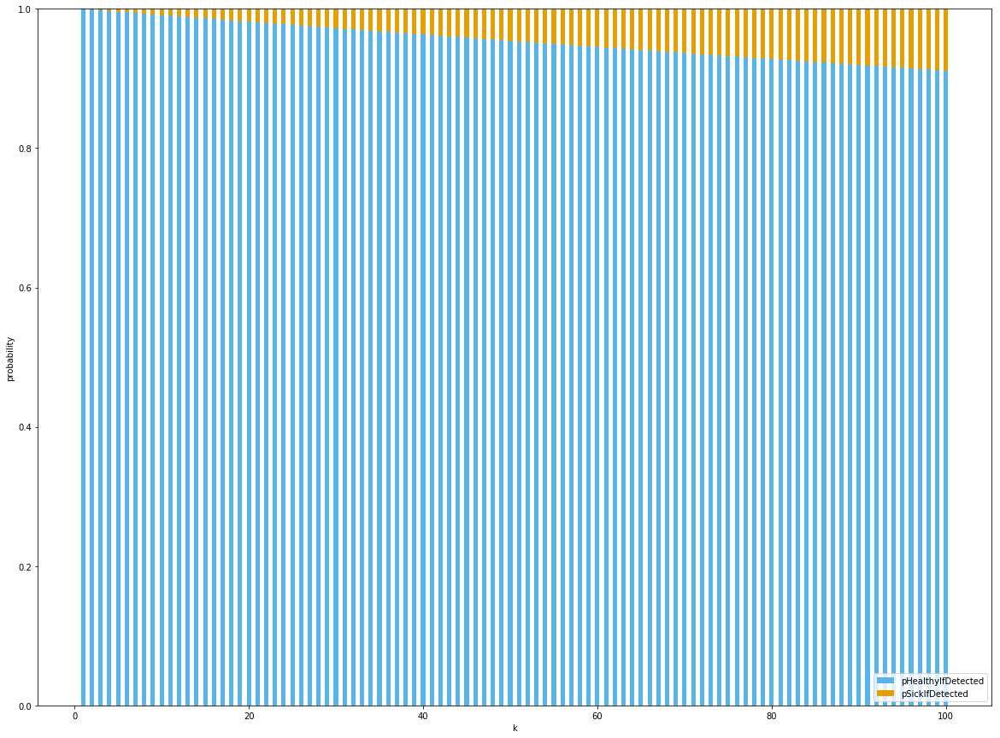

In [80]:
## Insert solution here
# D - ma chorobe
# ~D - nie ma choroby
# Pos - wynik pozytywny testu
# Neg - wynik negatywny
## P(D) = od 0.00002 do 0.002
## P(Pos|~D) = 0.02 P(Pos|D) = 0.98 
## P(Neg|D) = 0.01 P(Neg|~D) = 0.99
#P(D, Pos) = P(D)P(Pos|D) = od 0.0000196 do 0.00196
#P(~D, Pos) = P(~D)P(Pos|~D) ~ 0.02
#P(Pos) = P(D, Pos) + P(~D, Pos) ~ 0.02196 
#P(D|Pos) = P(Pos|D)P(D)/P(Pos) = 0.98 * (0.00002 do 0.002)/0.02 = 0.098 lub 0.00098
#P(~D|Pos) = P(Pos|~D)P(~D)/P(Pos) = 0.02 * (0.99998 do 0.998)/0.02 = 0.909 lub 0.00002
import matplotlib.pyplot as plt

def probability(k):
    pSick = k/50000
    pNotSick = 1 - pSick
    pTestIsPosIfNotSick = 0.02
    pTestIsPosIfSick = 1 - pTestIsPosIfNotSick
    pTestIsNegIfSick = 0.01
    pTestIsNegIfNotSick = 1 - pTestIsNegIfSick
    pSickAndPos = pSick*pTestIsPosIfSick
    pNotSickAndPos = pNotSick*pTestIsPosIfNotSick
    pPos = pNotSickAndPos + pSickAndPos
    pNeg = 1 - pPos
    pSickIfTestPos = pTestIsPosIfSick*pSick/pPos
    pNotSickIfTestPos = pTestIsPosIfNotSick*pNotSick/pPos
    return pSickIfTestPos, pNotSickIfTestPos

pSickIfDetected = []
pHealthyIfDetected = []

for i in range(100):
    pSickIfTestPos, pNotSickIfTestPos = probability(i)
    pSickIfDetected.append(pSickIfTestPos)
    pHealthyIfDetected.append(pNotSickIfTestPos)

plt.figure(figsize=(20,15))
plt.xlabel('k')
plt.ylabel('probability')
plt.bar(range(1,101), pHealthyIfDetected, width=0.5, color='#56B4E9',
       label='pHealthyIfDetected', align="center")
plt.bar(range(1,101), pSickIfDetected, width=0.5, bottom=pHealthyIfDetected, color='#E69F00', 
       label='pSickIfDetected', align='center')
plt.legend(['pHealthyIfDetected', 'pSickIfDetected'], loc=4)